# Ego4D Annotation Visualizations
This notebook has visualizations for Ego4D's different annotation types

## Prerequisites
Install all the packages in this notebook using [`requirements.txt`](https://github.com/facebookresearch/Ego4d/blob/main/notebooks/requirements.txt).

## **Useful Links:**

[Ego4D Docs - Start Here!](https://ego4d-data.org/docs/start-here/#Download-The-CLI)

[Data Overview](https://ego4d-data.org/docs/data-overview/)

[Official Ego4D Site](https://ego4d-data.org/)

# Setup

In [1]:
CLI_OUTPUT_DIR = '/vast/work/public/ml-datasets/ego4d/'
VERSION = 'v1'
MANIFEST_PATH = '/vast/work/public/ml-datasets/ego4d/v1/full_scale/manifest.csv'

In [2]:
# Setup
import sys
import os
if os.path.abspath(".") not in sys.path: # Allow us to use util files in the same dir
    sys.path.insert(0, os.path.abspath("."))

import av
import collections
import csv
import cv2
import functools
import json
import logging
import math
import matplotlib.collections as mc
import matplotlib.image as mpimg
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

import numpy as np
import pandas as pd
import random
import uuid
import warnings

from celluloid import Camera
from IPython.display import HTML
from iopath.common.file_io import PathManager
from itertools import groupby
from pprint import pprint
from nb_video_utils import _get_frames

%matplotlib inline
plt.rcParams["animation.html"] = "jshtml"

pathmgr = PathManager()

warnings.filterwarnings('ignore')

def vid_df_des(df):
    return f"#{len(df)} {df.duration_sec.sum()/60/60:.1f}h"
def vid_des(videos):
    return f"#{len(videos)} {sum((x.duration_sec for x in videos))/60/60:.1f}h"
def deserialize_str_list(list_: str):
    list_ = list_[1:-2]
    items = list_.split("', '")
    return list(map(lambda z: z.strip("'"), items))
def to_1D(series):
    return pd.Series([x for _list in series for x in _list])

# Video API


In [3]:
videos_df = pd.read_csv(MANIFEST_PATH)
videos_df['scenarios'] = videos_df['scenarios'].apply(deserialize_str_list)
def get_video(video_uid='353ae622-c322-443e-95b4-e9927dedfa1c'):
    return videos_df.loc[videos_df['video_uid'] == video_uid].iloc[0]
print(f"R1 Videos: {vid_df_des(videos_df)}")

R1 Videos: #9645 3876.3h


# Visualization Utils

In [4]:
# in: video_path, frame_number, boxes: [{ object_type, bbox: {x, y, width, height} }]}, draw_labels
# out: path to image of bboxes rendered onto the video frame
import cv2

def _get_frames(frame_numbers, input_video, **kwargs):
    """
    Extracts specified frames from a video file.
    
    Args:
        frame_numbers (list of int): List of frame indices to extract.
        input_video (str): Path to the input video file.
    
    Returns:
        dict: A dictionary mapping frame indices to the corresponding frames (as numpy arrays).
    """
    cap = cv2.VideoCapture(input_video)
    frames = []

    if not cap.isOpened():
        print("Error: Could not open video.")
        return frames

    for frame_number in frame_numbers:
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)  # Jump to the specified frame
        ret, frame = cap.read()
        if ret:
            frames.append(frame)
        else:
            print(f"Warning: Could not retrieve frame {frame_number}")

    cap.release()
    return frames

    
    
def render_frame_with_bboxes(video_path, frame_number, boxes, draw_labels = True):
    colormap = { # Custom colors for FHO annotations
        'object_of_change': (0, 255, 255),
        'left_hand': (0, 0, 255),
        'right_hand': (0, 255, 0)
    }
    defaultColor = (255, 255, 0)
    rect_thickness = 5
    rectLineType = cv2.LINE_4
    fontColor = (0, 0, 0)
    fontFace = cv2.FONT_HERSHEY_DUPLEX
    fontScale = 1
    fontThickness = 1
    with av.open(video_path) as input_video:
        frames = list(_get_frames([frame_number], video_path, include_audio=False, audio_buffer_frames=0))
        assert len(frames) == 1
        img = frames[0]#.to_ndarray(format="bgr24")
        for box in boxes:
            label, bbox = box['object_type'], box['bbox']
            rectColor = colormap.get(label, defaultColor) if label else defaultColor
            x, y, width, height = list(map(lambda x: int(x), [bbox['x'], bbox['y'], bbox['width'], bbox['height']]))
            cv2.rectangle(img, pt1=(x,y), pt2=(x+width, y+height), color=rectColor, thickness=rect_thickness, lineType=rectLineType)
            if label and draw_labels:
                textSize, baseline = cv2.getTextSize(label, fontFace, fontScale, fontThickness)
                textWidth, textHeight = textSize
                cv2.rectangle(img, pt1=(x - rect_thickness//2, y - rect_thickness//2), pt2=(x + textWidth + 10 + rect_thickness, y - textHeight - 10 - rect_thickness), color=rectColor, thickness=-1)
                cv2.putText(img, text=label, org=(x + 10, y - 10), fontFace=fontFace, fontScale=fontScale, color=fontColor, thickness=fontThickness, lineType=cv2.LINE_AA)
    path = f"/tmp/{frame_number}_{str(uuid.uuid1())}.jpg"
    cv2.imwrite(path, img)
    return path

# in: video_path, frames: [{ frame_number, frame_type, boxes: [{ object_type, bbox: {x, y, width, height} }] }]
# out: void; as a side-effect, renders frames from the video with matplotlib
def plot_frames_with_bboxes(video_path, frames, max_cols = 3):
    cols = min(max_cols, len(frames))
    rows = math.ceil(len(frames) / cols)
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(10*cols, 7 * rows))
    if len(frames) > 1:
        [axi.set_axis_off() for axi in axes.ravel()] # Hide axes
    for idx, frame_data in enumerate(frames):
        row = idx // max_cols
        col = idx % max_cols
        frame_path = render_frame_with_bboxes(video_path, frame_data['frame_number'], frame_data['boxes'])
        axes[row, col].title.set_text(frame_data['frame_type'])
        axes[row, col].imshow(mpimg.imread(frame_path, format='jpeg'))
    plt.subplots_adjust(wspace=.05, hspace=.05)
    plt.show()
    
# in: video_path, frames: [{ frame_number, frame_label, ?boxes: [{ label, bbox: {x, y, width, height }}] }]
# out: matplotlib.ArtistAnimation of frames rendered with bounding boxes (if provided)
def render_frames_animation(video_path, frames, **kwargs):
    fig, ax = plt.subplots(figsize=(15, 9))
    camera = Camera(fig)
    for frame in frames:
        boxes = frame.get('boxes', [])
        frame_path = render_frame_with_bboxes(video_path, frame['frame_number'], boxes)
        ax.text(0, 1.01, frame['frame_label'], fontsize=20.0, transform=ax.transAxes)
        plt.imshow(mpimg.imread(frame_path, format='jpeg'))
        camera.snap()
    plt.close(fig)
    return camera.animate(**kwargs)

# in: segments: [{<start_key>: int, <end_key>: int}]
# out: void; as a side effect, renders a plot showing all segments passed in
def plot_segments(segments, start_key, end_key):
    ordered_segs = sorted(segments, key=lambda x: x[start_key])
    lines = [[(x[start_key], i), (x[end_key], i)] for i, x in enumerate(ordered_segs)]

    lc = mc.LineCollection(lines, linewidths=2)
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.add_collection(lc)
    ax.autoscale()
    ax.set_xlabel('Frame', fontsize=15)
    ax.set_ylabel('Segment', fontsize=15)
    start, end = ax.get_xlim()
    stepsize = (end-start)/30
    ax.xaxis.set_ticks(np.arange(start, end, stepsize))
    plt.show()
    
# in: track: [ [{<start_key>: int, <end_key>: int, <label>: str}] ]
# out: void; as a side effect, renders a plot showing segments of each track passed in
def plot_multitrack_segments(tracks, start_key, end_key, label_key):
    cmap = plt.cm.get_cmap('tab20')
    color_palette = [cmap(x) for x in range(0, 20)]
    
    lines, colors, patches = [], [], []
    for i, segments in enumerate(tracks):
        lines += [[(x[start_key], i), (x[end_key], i)] for x in segments]
        color = color_palette[i % len(color_palette)]
        colors += [color for _ in segments]
        patches += [mpatches.Patch(color=color, label=segments[0][label_key])]

    lc = mc.LineCollection(lines, colors = colors, linewidths=550/len(tracks))
    fig, ax = plt.subplots(figsize=(30, 10))
    ax.legend(handles=patches, loc='upper left')
    ax.add_collection(lc)
    ax.autoscale()
    ax.set_xlabel('Frame', fontsize=15)
    ax.set_ylabel('Track', fontsize=15)
    start, end = ax.get_xlim()
    stepsize = (end-start)/30
    ax.xaxis.set_ticks(np.arange(start, end, stepsize))
    plt.show()

***

# Visual Object Queries (VQ)
[Data Overview](https://ego4d-data.org/docs/data-overview/#visual-object-queries)

In [5]:
# Load VQ
with pathmgr.open(os.path.join(CLI_OUTPUT_DIR, VERSION, 'annotations', 'vq_train.json'), "r") as f:
    vq_annotations = json.load(f)
    vq_ann_video_uids = [x["video_uid"] for x in vq_annotations["videos"]]
vq_video_dict = {x["video_uid"]: x["clips"] for x in vq_annotations["videos"]}
print(f"VQ: {len(vq_ann_video_uids)} videos - top level: {vq_annotations.keys()}")

VQ: 1324 videos - top level: dict_keys(['version', 'date', 'description', 'manifest', 'videos'])


In [6]:
# Sample one video
vq_video_uid = random.sample(vq_ann_video_uids, 1)[0]
vq_video = videos_df[videos_df.video_uid == vq_video_uid].iloc[0]
print(f"Sampled Video: {vq_video}")

Sampled Video: video_uid                                        c67cb1da-90ac-4da8-af17-4f8b77da9b9d
path                                s3://ego4d-minnesota/public/v1/full_scale/c67c...
duration_sec                                                                    831.4
scenarios                                                   [Clothes, other shopping]
split_em                                                                        train
split_av                                                                          NaN
split_fho                                                                         NaN
benchmarks                                                                       [EM]
origin_video_id                                               subject00006_video00039
video_source                                                                minnesota
device                                                                         Zshade
deid_scrubbed_audio                    

In [7]:
# Summarize VQ Annotations
vq_video_annotations = vq_video_dict.get(vq_video_uid)
print(f"VQ Video: {len(vq_video_annotations)}, clips: {vq_video_uid}")
print(f"clip keys: {vq_video_annotations[0].keys()}")
print(f"query set keys: {vq_video_annotations[0]['annotations'][0]['query_sets']['1'].keys()}\n")

VQ Video: 1, clips: c67cb1da-90ac-4da8-af17-4f8b77da9b9d
clip keys: dict_keys(['clip_uid', 'video_start_sec', 'video_end_sec', 'video_start_frame', 'video_end_frame', 'clip_start_sec', 'clip_end_sec', 'clip_start_frame', 'clip_end_frame', 'clip_fps', 'annotation_complete', 'source_clip_uid', 'annotations'])
query set keys: dict_keys(['is_valid', 'errors', 'warnings', 'query_frame', 'query_video_frame', 'response_track', 'object_title', 'visual_crop'])



In [8]:
# If this errors out, make sure you used the cli to download the video with this uid
vq_video_path = os.path.join(CLI_OUTPUT_DIR, VERSION, 'full_scale', vq_video_uid + '.mp4')
assert os.path.exists(vq_video_path), f"Video {vq_video_uid} not found. Download it with the cli using: python3 -m ego4d.cli.cli --output_directory=\"<output_dir>\" --datasets full_scale --video_uids={vq_video_uid} --yes"

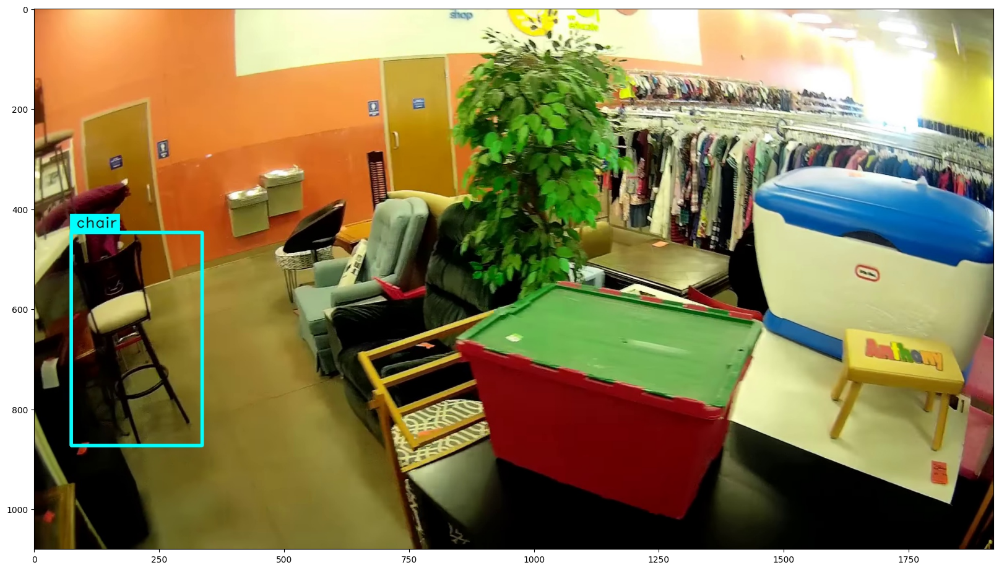

In [9]:
# Display visual crop frame
query_set = vq_video_annotations[0]['annotations'][0]['query_sets']['1']
object_frame = query_set['visual_crop']
box = {
    'object_type': query_set['object_title'],
    'bbox': {
        'x': object_frame['x'],
        'y': object_frame['y'],
        'width': object_frame['width'],
        'height': object_frame['height'],
    }
}
object_frame_path = render_frame_with_bboxes(vq_video_path, object_frame['video_frame_number'], [box])
plt.rcParams['figure.figsize'] = [20, 20]
plt.imshow(mpimg.imread(object_frame_path, format='jpeg'))
plt.show()

In [10]:
# Display animated response track
response_track_frames = query_set['response_track']
reformatted_frames = list(map(
    lambda frame:
        {
            'frame_number': frame['video_frame_number'],
            'frame_label': f"Frame: {frame['video_frame_number']}",
            'boxes': [{
                'object_type': query_set['object_title'],
                'bbox': {
                    'x': frame['x'],
                    'y': frame['y'],
                    'width': frame['width'],
                    'height': frame['height'],
                }
            }]
        }, response_track_frames))
render_frames_animation(vq_video_path, reformatted_frames, interval=200)

Animation size has reached 21485139 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Natural Language Queries (NLQ)

[Data Overview](https://ego4d-data.org/docs/data-overview/#natural-language-queries)

In [11]:
# Load NLQ
with pathmgr.open(os.path.join(CLI_OUTPUT_DIR, VERSION, 'annotations', 'nlq_train.json'), "r") as f:
    nlq_annotations = json.load(f)
    nlq_ann_video_uids = [x["video_uid"] for x in nlq_annotations["videos"]]
nlq_video_dict = {x["video_uid"]: x["clips"] for x in nlq_annotations["videos"]}
print(f"NLQ: {len(nlq_ann_video_uids)} videos - top level: {nlq_annotations.keys()}")

NLQ: 754 videos - top level: dict_keys(['version', 'date', 'description', 'manifest', 'videos'])


In [12]:
# Sample one video
nlq_video_uid = random.sample(nlq_ann_video_uids, 1)[0]
nlq_video = videos_df[videos_df.video_uid == nlq_video_uid].iloc[0]
print(f"Sampled Video: {nlq_video}")

Sampled Video: video_uid                                        edd7c8bc-4b17-4c2c-89d1-16de9e7f8fd9
path                                s3://ego4d-cmu/public/v1/full_scale/edd7c8bc-4...
duration_sec                                                                   1080.2
scenarios                                                              [Car mechanic]
split_em                                                                        train
split_av                                                                          NaN
split_fho                                                                         NaN
benchmarks                                                                       [EM]
origin_video_id                                                               P8_0158
video_source                                                                      cmu
device                                                             GoPro Hero Black 8
deid_scrubbed_audio                    

In [13]:
# Summarize NLQ Annotations
nlq_video_annotations = nlq_video_dict.get(nlq_video_uid)
print(f"NLQ Video: {len(nlq_video_annotations)}, clips: {nlq_video_uid}")
print(f"clip keys: {nlq_video_annotations[0].keys()}")
print(f"language_query keys: {nlq_video_annotations[0]['annotations'][0]['language_queries'][0].keys()}\n")

NLQ Video: 2, clips: edd7c8bc-4b17-4c2c-89d1-16de9e7f8fd9
clip keys: dict_keys(['clip_uid', 'video_start_sec', 'video_end_sec', 'video_start_frame', 'video_end_frame', 'clip_start_sec', 'clip_end_sec', 'clip_start_frame', 'clip_end_frame', 'source_clip_uid', 'annotations'])
language_query keys: dict_keys(['clip_start_sec', 'clip_end_sec', 'video_start_sec', 'video_end_sec', 'video_start_frame', 'video_end_frame', 'template', 'query', 'slot_x', 'verb_x', 'raw_tags'])



In [14]:
# If this errors out, make sure you used the cli to download the video with this uid
nlq_video_path = os.path.join(CLI_OUTPUT_DIR, VERSION, 'full_scale', nlq_video_uid + '.mp4')
assert os.path.exists(nlq_video_path), f"Video {nlq_video_uid} not found. Download it with the cli using: python3 -m ego4d.cli.cli --output_directory=\"<output_dir>\" --datasets full_scale --video_uids={nlq_video_uid} --yes"

In [15]:
# Display the clip for a language query
nlq_clip = random.sample(nlq_video_annotations, 1)[0]
nlq_clip_annotations = random.sample(nlq_clip['annotations'], 1)[0]
sample_nlq_language_query = random.sample(nlq_clip_annotations['language_queries'], 1)[0]

[print(k.capitalize(),':',v) for k, v in sample_nlq_language_query.items()]

# only render 15 frames for performance
nlq_stepsize = (sample_nlq_language_query["video_end_frame"] - sample_nlq_language_query["video_start_frame"]) // 15 
render_frames_animation(
    nlq_video_path,
    [
        {"frame_number": x, "frame_label": f"Frame {x}"}
        for x in range(
            sample_nlq_language_query["video_start_frame"],
            sample_nlq_language_query["video_end_frame"],
            nlq_stepsize
        )
    ],
    interval = 400
)

Clip_start_sec : 333.09949
Clip_end_sec : 334.73238
Video_start_sec : 963.0994900000001
Video_end_sec : 964.7323799999999
Video_start_frame : 32405
Video_end_frame : 32405
Template : Objects: How many X’s? (quantity question)
Query : How many plier did I pick?
Slot_x : plier did I pick
Verb_x : pick
Raw_tags : ['Objects: How many X’s? (quantity question)', 'How many plier did I pick?', 'plier did I pick', 'pick']


ValueError: range() arg 3 must not be zero